# Размером атома водорода

In [72]:
using Plots
using Random

### Интегрирование методом Монте-Карло

Методы Монте-Карло - это статистическое моделирование, в котором используются последовательности случайных чисел. В качестве примера мы можем рассмотреть круг радиусом $r=1$, помещенный внутри квадрата со сторонами длиной 2. Затем мы можем сгенерировать два случайных числа, $x$ и $y$, соответствующих точке $(x,y)$ внутри квадрата. На рисунке ниже мы построили квадрат и круг и сгенерировали 10 случайных точек, которые также включены в график.

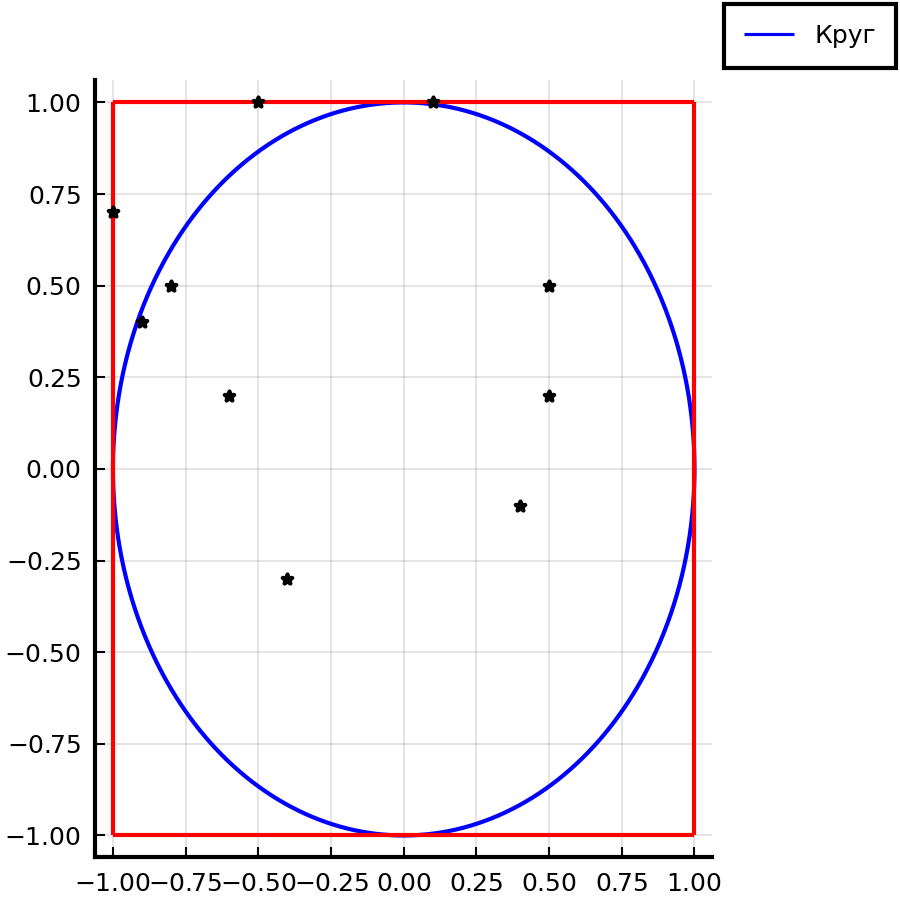

sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


In [73]:
# Установка общих параметров графика
default(titlefontsize=7, labelfontsize=6, linewidth=1, dpi=300, markersize=2.4, legendfontsize=6)
pyplot(size=(300, 300))

# Построение круга
θ = range(0, stop=2π, length=2000)
plot(cos.(θ), sin.(θ), color="blue", label="Круг")

# Построение квадрата
plot!([-1, 1], [-1, -1], color="red", label="")
plot!([-1, 1], [1, 1], color="red", label="")
plot!([-1, -1], [-1, 1], color="red", label="")
plot!([1, 1], [-1, 1], color="red", label="")

# Генерация двух наборов из 10 случайных чисел
x = rand(-1:0.1:1, 10)
y = rand(-1:0.1:1, 10)
scatter!(x, y, color="black", marker=:star5, label="", markersize=2.4)

# Установка шага на обеих осях
xticks!(-1:0.25:1)
yticks!(-1:0.25:1)

Из рисунка мы видим, что многие точки расположены внутри круга, и мы можем определить, находятся ли они внутри
$$\sqrt{x^2+y^2} \leq r.$$
Для большого числа случайных точек, $N$, разумно предположить, что выполняется следующее соотношение
$$\frac{n}{N}=\frac{V_\mathrm{circ}}{V_\mathrm{square}},$$
где $n$-количество точек внутри круга, а $V_\mathrm{circ}$ и $V_\mathrm{square}$ - "объем" (в 2-D, очевидно, это площадь) круга и квадрата соответственно. Чтобы интегрировать функцию $f(x,y)$ по площади круга, мы просто добавляем значение функции в каждой точке внутри круга,
$$ I =\frac{V_\mathrm{square}}{N} \left[ \sum_{n} f(x,y) \right]. $$

По сути, это представляет собой сумму Римана с управляющими объемами $\Delta V=V_\mathrm{square}/N$ и функцией $f(x,y)$, которая установлена равной нулю за пределами круга.

В качестве краткой демонстрации мы можем интегрировать функцию $f(x,y)=\sqrt{x^2+y^2}=r=f(r)$ по окружности радиуса $r=1$. Выберем $N = 10^5$ и $V_\mathrm{square}=(2r)^2=4$.

In [16]:
N = 1e6
V = 4
n = 0

# Устанавливаем генератор случайных чисел
Random.seed!(1234)

for i in 1:N
    x = rand(-1:0.000001:1)
    y = rand(-1:0.000001:1)
    r = sqrt(x^2 + y^2)
    if r <= 1
        n += r
    end
end

I = V / N * n
println("Monte Carlo integral: ", I)
println("Analytical integral: ", 2/3 * π)

Monte Carlo integral: 2.093365142851046
Analytical integral: 2.0943951023931953


Как мы видим, точность довольно хорошая! Метод, описанный выше, также может быть использован в трех и более измерениях.

Теперь вернемся к атому водорода...

### Атом Водорода

Волновая функция 1s-состояния атома водорода определяется

$$
\psi_{100}(r) = \frac{1}{\sqrt{\pi a^3}}\exp(-r/a),
$$

и она не зависит от $\theta$ и $\phi$, и где $a=0.529$ Å - радиус Бора. Плотность вероятности определяется 

$$
\left|\psi_{100}(r)\right|^2 =\frac{1}{\pi a^3}\exp(-2r/a).
$$

Используя интегрирование методом Монте-Карло, ниже рассчитывается интеграл плотности вероятности внутри сферы радиуса $a$, радиуса Бора. Также вычисляется аналитическое значение.

In [74]:
# Устанавливаем количество случайных чисел
N = 1.0e5

# Боровский радиус и количество Боровских радиусов для интеграции
a = 0.529e-10
j = 1.0

# Счетчик инициализируется
i = 0

# Счетчик для подсчета числа точек, которые попадают внутрь одного Боровского радиуса
n = 0.0

# Устанавливаем генератор случайных чисел
Random.seed!(123)  # Фиксируем генератор случайных чисел для воспроизводимости

# Генерация случайных чисел и подсчет вероятности
while i < N
    x = rand() * 2 * j * a - j * a
    y = rand() * 2 * j * a - j * a
    z = rand() * 2 * j * a - j * a
    r = sqrt(x^2 + y^2 + z^2)
    if r <= j*a
        n += exp(-2*r/a) / (pi*a^3)
    end
    i += 1
end

# Вычисление вероятности в пределах одного Боровского радиуса
prob = n/N * (2*j*a)^3
println("Вероятность в пределах одного Боровского радиуса: ", prob)

# Вычисление аналитической вероятности
prob_analytical = 1 - exp(-2*j)*(1 + 2*j + 2*j^2)
println("Аналитическая вероятность: ", prob_analytical)


Вероятность в пределах одного Боровского радиуса: 0.322435319767456
Аналитическая вероятность: 0.3233235838169365


Мы видим, что снова наблюдается хорошее соответствие между вычисленными и аналитическими значениями.

Довольно удивительно, что вероятность нахождения электрона в пределах одного радиуса Бора составляет всего 0,32, и все же это считается размером атома водорода!

Другой способ дает аналогичный результат с Аналитической вероятностью с точностью до 14-го знака

In [75]:
using QuadGK

# Функция для расчета вероятности в пределах одного Боровского радиуса для атома водорода
function probability_within_bohr_radius()
    a₀ = 0.52917721067  # Боровский радиус в ангстремах

    # Волновая функция атома водорода
    ψ(r) = (1 / sqrt(pi)) * (1 / a₀)^(3/2) * exp(-r / a₀)

    # Интегрирование квадрата волновой функции в пределах от 0 до a₀
    prob, _ = quadgk(r -> abs2(ψ(r)) * 4 * pi * r^2, 0, a₀)
    return prob
end

# Вычисление вероятности в пределах одного Боровского радиуса для атома водорода
prob = probability_within_bohr_radius()
println("Вероятность в пределах одного Боровского радиуса для атома водорода: ", prob)


Вероятность в пределах одного Боровского радиуса для атома водорода: 0.3233235838169365


Ниже приведен контурный график плотности вероятности для состояния 1s, как показано на $xy$-плоскости.

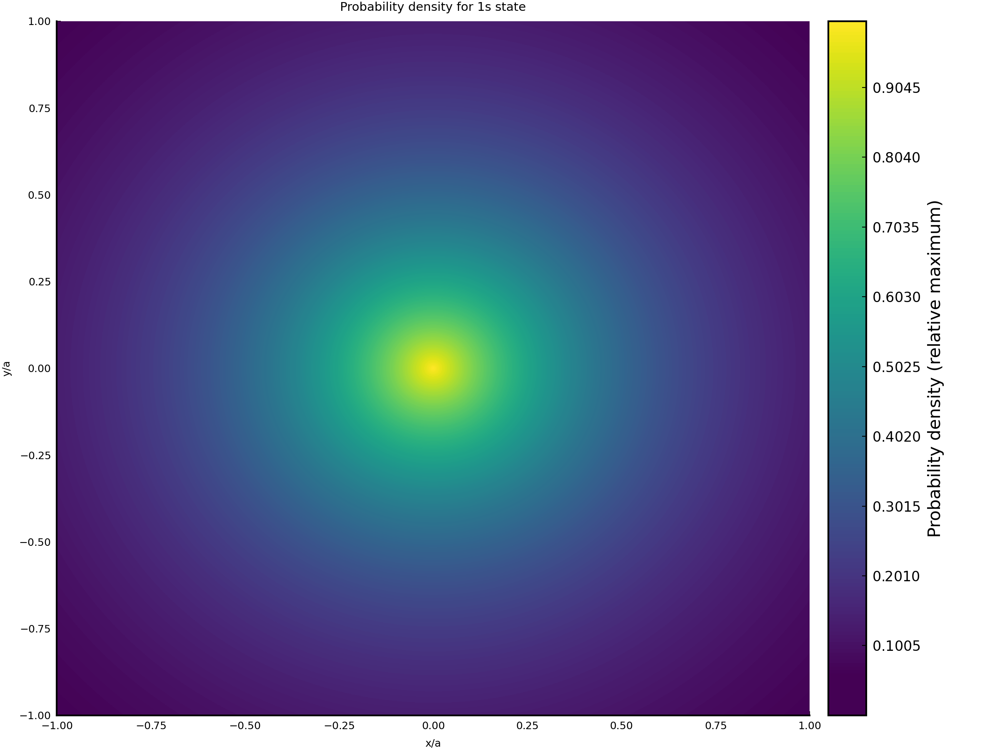

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'


In [76]:
using Plots

# Set common figure parameters
Plots.default(titlefontsize=7, labelfontsize=6,
              linewidth=1, dpi=300, 
              legendfontsize=6, legendtitlefontsize=6, legend=:outertopright, 
              tickfontsize=6, guidefontsize=6,
              legendtitle=false)

# Remaining code stays the same
N = 1.0e5     # Number of random numbers
a = 0.529e-10 # Bohr radius
i = 0
n = 0.0
j = 1.0
p = 1000
xs = range(-j*a, j*a, length=p)
X = repeat(reshape(xs, 1, :), p, 1)
Y = repeat(xs, 1, p)
psi2 = zeros(p, p)

r = sqrt.(X.^2 .+ Y.^2)

psi2 = exp.(-2*r/a)/(pi*a^3)

contourf(X/a, Y/a, psi2*(pi*a^3), levels=range(0, 1, length=200),
         xlabel="x/a", ylabel="y/a", title="Probability density for 1s state",
         color=:viridis, colorbar_title="Probability density (relative maximum)",
         aspect_ratio=:auto, 
         colorbar_ticks=0:0.1005:1, 
         colorbar_ticklabel=0:0.1005:1,
         size=(800, 600))  # Установка размера графика в пикселях (800x600)

xticks!(-1:0.25:1)
yticks!(-1:0.25:1)